# Investigating bot statistics

## Download or load data

Here download a new dataset if desired or load an already downloaded one

### Downloading data:

In [2]:
# We don't want to exceed the max limit of bot checks
# So give it here and stop running if it is reached
botometer_max_limit = 1800
bot_check_count = 0

In [3]:
import snscrape.modules.twitter as sntwitter
import pandas as pd
from tqdm import tqdm

In [4]:
# Just pandas display options
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)

/var/folders/hx/0dxb0wn51wx5pscstjkwf2gc000qqf/T/ipykernel_29352/1119663756.py:5: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


In [4]:
# A function to create a pair of lists for days to search
def create_date_lists(since_initial, until_final):
    """
    Creates a a pair of lists for since and until dates of the form
    since_list = ['2022-02-24', '2022-02-25', '2022-02-26']
    until_list = ['2022-02-25', '2022-02-26', '2022-02-27']
    """
    import datetime

    diff = datetime.datetime.strptime(until_final, "%Y-%m-%d") - datetime.datetime.strptime(since_initial, "%Y-%m-%d")
    diff = diff.days

    since_initial_datetime = datetime.datetime.strptime(since_initial, "%Y-%m-%d")
    until_initial_datetime = since_initial_datetime + datetime.timedelta(days=1)
    until_initial_datetime = datetime.datetime.strftime(until_initial_datetime, "%Y-%m-%d")

    diff = datetime.datetime.strptime(until_final, "%Y-%m-%d") - datetime.datetime.strptime(since_initial, "%Y-%m-%d")
    diff = diff.days

    since_list = []
    until_list = []
    for day in range(diff):
        since_plus_day = since_initial_datetime + datetime.timedelta(days=day)
        since_plus_day = datetime.datetime.strftime(since_plus_day, "%Y-%m-%d")
        since_list.append(since_plus_day)

        until_plus_day = since_initial_datetime + datetime.timedelta(days=day+1)
        until_plus_day = datetime.datetime.strftime(until_plus_day, "%Y-%m-%d")
        until_list.append(until_plus_day)
        
    return since_list, until_list

In [5]:
import time
import datetime
import numpy as np

# Each word seperated by a space is treated as a unique keyword here
#keywords_en = 'england france rugby' 
#keywords_en = ['england rugby', 'france rugby', 'england six nations', 'france six nations']
#keywords_en = ['rugby', 'six_nations']
#keywords_en = ['ukraine peace talks', 'ukraine peace', 'ukraine talks', 'russia peace', 'russia talks'] 
keywords_en = ['ukraine russia']
keywords_ru = 'макдональдс россия'
keywords_uk = 'макдональдс росія'

# We can get a number of tweets from each day 
num_tweets_per_day = 500
start_date = '2022-02-19'
end_date = '2022-03-31'
#start_date = '2022-03-27'
#end_date = '2022-03-28'

# Use our function to get a pair of lists for each day
since_list, until_list = create_date_lists(start_date, end_date)

def scrape_tweets_by_keywords(keywords, lang, since_list, until_list, user_created_after = None):
    
    """
    Get tweets using snscrape. If user_created_after is specified, only save tweets if the user was 
    created after that date. Date format is YYYY-MM-DD.
    
    If you use you see 'Total suitable tweets found' is fewer than the total, it means you have 
    found all the tweets for that day.
    """
    
    # Loop through each since and until date in the since and until lists, create a dataframe for each day and stitch them together
    tweets_lang_df = pd.DataFrame(columns=['Datetime', 'Tweet Id', 'Text', 'Username', 'Like Count', 'Display Name', 'Language'])
    for day, (since,until) in enumerate(list(zip(since_list, until_list))):
        print("Day:", day)
        tweets_list = []
        
        # We want to avoid duplicate tweets if going through multiple keywords in the same day
        daily_tweet_list = []        
        for keyword in keywords:
            
            
            # Split the total number of tweets per day evenly over all keywords
            num_tweets = int(np.floor(num_tweets_per_day/len(keywords)))

            print("Keyword:", keyword)
            
            pbar = tqdm(sntwitter.TwitterSearchScraper(keyword + ' since:' + since + ' until:' + until + ' lang:' + lang).get_items())
            
            tweet_idx = 0
            #for i,tweet in enumerate(tqdm(sntwitter.TwitterSearchScraper(keyword + ' since:' + since + ' until:' + until + ' lang:' + lang).get_items())):
            for i,tweet in enumerate(pbar):    
                
                # Use a custom counter here since we will get fewer tweets when filtering by user creation date
                if tweet_idx >= num_tweets:
                    break

                user_created = tweet.user.created
                user_created = datetime.datetime.strftime(user_created, "%Y-%m-%d")
                #TODO add a statement to not add users in the organisation list
                # Would be better to do it here rather than later, but for now it doesn't matter
                if user_created_after is not None:
                    if user_created > user_created_after:
                        if tweet.id not in daily_tweet_list:
                            tweets_list.append([tweet.date, tweet.id, tweet.content, tweet.user.username, tweet.likeCount, tweet.user.displayname, tweet.lang, user_created])
                            daily_tweet_list.append(tweet.id)
                            tweet_idx += 1
                                
                else:
                    if tweet.id not in daily_tweet_list:
                        tweets_list.append([tweet.date, tweet.id, tweet.content, tweet.user.username, tweet.likeCount, tweet.user.displayname, tweet.lang, user_created])
                        daily_tweet_list.append(tweet.id)
                        tweet_idx += 1
                    
                pbar.set_postfix_str('Total suitable tweets found %s/%s' % (tweet_idx, num_tweets))
                    

        # Creating a dataframe from the tweets list above
        tweets_lang_day_df = pd.DataFrame(tweets_list, columns=['Datetime', 'Tweet Id', 'Text', 'Username', 'Like Count', 'Display Name', 'Language', 'User Created'])

        # Stitch the daily dataframes together
        tweets_lang_df = pd.concat([tweets_lang_df, tweets_lang_day_df])
        tweets_lang_df.reset_index(drop=True, inplace=True)
        
    return tweets_lang_df 


tweets_en_df = scrape_tweets_by_keywords(keywords_en, 'en', since_list, until_list)
#tweets_en_df = scrape_tweets_by_keywords(keywords_en, 'en', since_list, until_list, "2022-01-01")
#tweets_ru_df = scrape_tweets_by_keywords(keywords_ru, 'ru', since_list, until_list)
#tweets_uk_df = scrape_tweets_by_keywords(keywords_uk, 'uk', since_list, until_list)
tweets_en_df.head(2000)

Day: 0
Keyword: ukraine russia


500it [00:19, 26.27it/s, Total suitable tweets found 500/500]


Day: 1
Keyword: ukraine russia


500it [00:18, 27.42it/s, Total suitable tweets found 500/500]


Day: 2
Keyword: ukraine russia


500it [00:16, 29.47it/s, Total suitable tweets found 500/500]


Day: 3
Keyword: ukraine russia


500it [00:17, 28.75it/s, Total suitable tweets found 500/500]


Day: 4
Keyword: ukraine russia


500it [00:18, 27.77it/s, Total suitable tweets found 500/500]


Day: 5
Keyword: ukraine russia


500it [00:17, 27.90it/s, Total suitable tweets found 500/500]


Day: 6
Keyword: ukraine russia


500it [00:17, 27.95it/s, Total suitable tweets found 500/500]


Day: 7
Keyword: ukraine russia


500it [00:17, 27.90it/s, Total suitable tweets found 500/500]


Day: 8
Keyword: ukraine russia


500it [00:17, 27.78it/s, Total suitable tweets found 500/500]


Day: 9
Keyword: ukraine russia


500it [00:18, 26.57it/s, Total suitable tweets found 500/500]


Day: 10
Keyword: ukraine russia


500it [00:17, 27.92it/s, Total suitable tweets found 500/500]


Day: 11
Keyword: ukraine russia


500it [00:18, 27.46it/s, Total suitable tweets found 500/500]


Day: 12
Keyword: ukraine russia


500it [00:18, 27.14it/s, Total suitable tweets found 500/500]


Day: 13
Keyword: ukraine russia


500it [00:17, 29.25it/s, Total suitable tweets found 500/500]


Day: 14
Keyword: ukraine russia


500it [00:17, 27.92it/s, Total suitable tweets found 500/500]


Day: 15
Keyword: ukraine russia


500it [00:18, 27.60it/s, Total suitable tweets found 500/500]


Day: 16
Keyword: ukraine russia


500it [00:19, 26.11it/s, Total suitable tweets found 500/500]


Day: 17
Keyword: ukraine russia


500it [00:18, 27.20it/s, Total suitable tweets found 500/500]


Day: 18
Keyword: ukraine russia


500it [00:18, 26.81it/s, Total suitable tweets found 500/500]


Day: 19
Keyword: ukraine russia


500it [00:17, 28.76it/s, Total suitable tweets found 500/500]


Day: 20
Keyword: ukraine russia


500it [00:17, 28.43it/s, Total suitable tweets found 500/500]


Day: 21
Keyword: ukraine russia


500it [00:17, 27.92it/s, Total suitable tweets found 500/500]


Day: 22
Keyword: ukraine russia


500it [00:17, 28.57it/s, Total suitable tweets found 500/500]


Day: 23
Keyword: ukraine russia


500it [00:18, 27.15it/s, Total suitable tweets found 500/500]


Day: 24
Keyword: ukraine russia


500it [00:17, 28.92it/s, Total suitable tweets found 500/500]


Day: 25
Keyword: ukraine russia


500it [00:17, 29.35it/s, Total suitable tweets found 500/500]


Day: 26
Keyword: ukraine russia


500it [00:18, 27.51it/s, Total suitable tweets found 500/500]


Day: 27
Keyword: ukraine russia


500it [00:17, 27.92it/s, Total suitable tweets found 500/500]


Day: 28
Keyword: ukraine russia


500it [00:17, 27.85it/s, Total suitable tweets found 500/500]


Day: 29
Keyword: ukraine russia


500it [00:19, 25.51it/s, Total suitable tweets found 500/500]


Day: 30
Keyword: ukraine russia


500it [00:18, 27.44it/s, Total suitable tweets found 500/500]


Day: 31
Keyword: ukraine russia


500it [00:17, 27.93it/s, Total suitable tweets found 500/500]


Day: 32
Keyword: ukraine russia


500it [00:18, 26.99it/s, Total suitable tweets found 500/500]


Day: 33
Keyword: ukraine russia


500it [00:18, 26.87it/s, Total suitable tweets found 500/500]


Day: 34
Keyword: ukraine russia


500it [00:19, 25.59it/s, Total suitable tweets found 500/500]


Day: 35
Keyword: ukraine russia


500it [00:16, 29.95it/s, Total suitable tweets found 500/500]


Day: 36
Keyword: ukraine russia


500it [00:17, 28.75it/s, Total suitable tweets found 500/500]


Day: 37
Keyword: ukraine russia


500it [00:19, 25.23it/s, Total suitable tweets found 500/500]


Day: 38
Keyword: ukraine russia


500it [00:18, 27.58it/s, Total suitable tweets found 500/500]


Day: 39
Keyword: ukraine russia


500it [00:17, 28.24it/s, Total suitable tweets found 500/500]


,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,User Created
0,2022-02-19 23:59:58+00:00,1495186430443720709,"#Russia/#Ukraine Post\n@Militarylandnet 10m\nRussian military convoy, Belgorod Region. Z sign and three dots in circle marking #Russia \nhttps://t.co/UUraYd8Xq2 https://t.co/u1NZziE0nu",rien4djri,1,Outposts,en,2013-07-24
1,2022-02-19 23:59:56+00:00,1495186419689693187,"So russia has the country of Ukraine🇺🇦 surroundedwith 150,000 troops and we send 6,000 troops to surrounding country's... Put 8,500 more troops on high alert here at home🇺🇸.... And then start talking shit like we have the whole country ready for war??? @KamalaHarris @POTUS WTF!🗣",MistaWilson513,0,Mista Wilson513,en,2022-01-23
2,2022-02-19 23:59:54+00:00,1495186412970430464,"@nfseverin1 @RichardHanania You say, stop telling other countries what to do, as Russia tells Ukraine it can't join NATO if it decides it wants to. The irony.",Jfweston78,0,Jay W 🇺🇲👨‍🔬💻💹〽️,en,2011-01-05
3,2022-02-19 23:59:52+00:00,1495186403772272643,Why Ukraine matters: What to know about the crisis with Russia https://t.co/asT79bLpC1,theusarticles,0,Theusarticles,en,2022-01-15
4,2022-02-19 23:59:52+00:00,1495186402409078796,39 Ukrainian towns and villages were shelled by Russian forces today.\nVia @lapatina_ \n#Ukraine #Russia #Donbass,IntelRogue,1,Intel Rogue,en,2019-03-01
5,2022-02-19 23:59:49+00:00,1495186392183451654,"Where did Bernie blame any of America’s problems on Russia? He said Putin shouldn’t invade Ukraine and start a war. Even if America did absolutely nothing and let Russia invade Ukraine unimpeded, as tankies clearly want, his statement would still be just as true. https://t.co/wr9KttiRuu",AlCabbage045,8,El Cabbage Stands With Ukraine 🇺🇦,en,2015-05-09
6,2022-02-19 23:59:47+00:00,1495186383509590016,"What's happening in Ukraine shouldn't happen with any European country, including who are teorically allied with @NATO. Will those country leaders have a good sleep, knowing that Russia is coming for them?\n@ZelenskyyUa must recongnize the need for foreign soldiers in Ukraine.",qubit_age,0,Daily Redpill,en,2019-03-10
7,2022-02-19 23:59:41+00:00,1495186358549336064,BBC News - Ukraine: Russia plans biggest war in Europe since 1945 - Boris Johnson\nhttps://t.co/V6rNBRZo6p,ukprepperlife,0,ukprepper.life,en,2020-09-29
8,2022-02-19 23:59:41+00:00,1495186357664235526,"@ByeByeBoris @KI33RAN @GaryLineker Russia has not threatened to invade at all, and has said so repeatedly. Ukraine has been attacking Donbass, where huge amount of Russian speaking/ culture for past eight years or so. If full scale attack on Donbass, I suspect Russia will have no choice to protect them somehow",Kev_____l,0,"Kevin one of the 17,410,742",en,2009-07-02
9,2022-02-19 23:59:40+00:00,1495186354619273221,"Child: Mommy, where are all those trucks going\n\nMom: They are going to build a few bridges and catch fish in the 🇺🇦#Ukraine\n\nChild: U--what\n\nMom: Quiet!\n\n🇷🇺#Russia https://t.co/vdvOmdoofl",ChrliesWarchest,4,Devi Rhamesz,en,2011-03-06


In [6]:
tweets_en_df.shape

(20000, 8)

### Save downloaded tweets

In [7]:
tweets_en_df.to_csv('data/tweets_raw_en_df_ukraine_feb-march.csv')

### Filter out any organisational accounts

In [8]:
import numpy as np
organisations_list = list(np.genfromtxt('organisations.csv',delimiter=',',dtype=str, encoding='utf-8')[:,0])

tweets_en_df_dropped = tweets_en_df.copy()
for organisation_name in organisations_list:
    tweets_en_df_dropped = tweets_en_df_dropped.drop(tweets_en_df_dropped[tweets_en_df_dropped['Display Name'].str.lower().str.contains(str.lower(organisation_name))].index)
    tweets_en_df_dropped = tweets_en_df_dropped.drop(tweets_en_df_dropped[tweets_en_df_dropped['Username'].str.lower().str.contains(str.lower(organisation_name))].index)
    
tweets_en_df = tweets_en_df_dropped.copy()
tweets_en_df = tweets_en_df.reset_index(drop=True)

In [12]:
tweets_en_df = tweets_en_df.reset_index(drop=True)
tweets_en_df.head(2000)

,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,User Created
0,2022-02-19 23:59:56+00:00,1495186419689693187,"So russia has the country of Ukraine🇺🇦 surroundedwith 150,000 troops and we send 6,000 troops to surrounding country's... Put 8,500 more troops on high alert here at home🇺🇸.... And then start talking shit like we have the whole country ready for war??? @KamalaHarris @POTUS WTF!🗣",MistaWilson513,0,Mista Wilson513,en,2022-01-23
1,2022-02-19 23:59:54+00:00,1495186412970430464,"@nfseverin1 @RichardHanania You say, stop telling other countries what to do, as Russia tells Ukraine it can't join NATO if it decides it wants to. The irony.",Jfweston78,0,Jay W 🇺🇲👨‍🔬💻💹〽️,en,2011-01-05
2,2022-02-19 23:59:52+00:00,1495186402409078796,39 Ukrainian towns and villages were shelled by Russian forces today.\nVia @lapatina_ \n#Ukraine #Russia #Donbass,IntelRogue,1,Intel Rogue,en,2019-03-01
3,2022-02-19 23:59:41+00:00,1495186358549336064,BBC News - Ukraine: Russia plans biggest war in Europe since 1945 - Boris Johnson\nhttps://t.co/V6rNBRZo6p,ukprepperlife,0,ukprepper.life,en,2020-09-29
4,2022-02-19 23:59:41+00:00,1495186357664235526,"@ByeByeBoris @KI33RAN @GaryLineker Russia has not threatened to invade at all, and has said so repeatedly. Ukraine has been attacking Donbass, where huge amount of Russian speaking/ culture for past eight years or so. If full scale attack on Donbass, I suspect Russia will have no choice to protect them somehow",Kev_____l,0,"Kevin one of the 17,410,742",en,2009-07-02
5,2022-02-19 23:59:40+00:00,1495186354619273221,"Child: Mommy, where are all those trucks going\n\nMom: They are going to build a few bridges and catch fish in the 🇺🇦#Ukraine\n\nChild: U--what\n\nMom: Quiet!\n\n🇷🇺#Russia https://t.co/vdvOmdoofl",ChrliesWarchest,4,Devi Rhamesz,en,2011-03-06
6,2022-02-19 23:59:39+00:00,1495186350483681287,Ukraine: Russia plans biggest war in Europe since 1945 - Boris Johnson https://t.co/fWcVsYdtXq,dave1agar,0,Dave Agar,en,2009-03-11
7,2022-02-19 23:59:39+00:00,1495186347077812227,@maximusmadham @spectatorindex This is not a Russia-NATO war. It’s Russia versus Ukraine.,andruwins,1,andru,en,2022-01-16
8,2022-02-19 23:59:38+00:00,1495186343957250052,@UMHmanga___ Russia invading Ukraine is imminent and U.S and international media will tag Putin as the new “Hitler”,Rashydd_,0,Abdulrasheed Babayo,en,2011-05-17
9,2022-02-19 23:59:32+00:00,1495186317646438424,Important thread to understand related/relevant matters connected to the US Russia relationship. Provides nuance to the current crisis over Ukraine. Indicates how monetary transactions below the radar might have a bearing on geopolitics. @AamAadmiParty @AAPMaharashtra @AAPMumbai https://t.co/f2vtXG4wtT,kishoremandhyan,0,Kishore Mandhyan,en,2016-11-29


In [10]:
tweets_en_df.to_csv('data/tweets_raw_en_df_individual_ukraine_feb-march.csv')

In [9]:
print(tweets_en_df.shape, tweets_en_df_dropped.shape)

(16527, 8) (16527, 8)


### Now check for bots

In [13]:
import json
import botometer

# Load my API keys
with open("../twitter_keys_config.json") as twitter_cfg_file:
    twitter_config = json.load(twitter_cfg_file)

with open("../rapidapi_keys_config.json") as rapidapi_cfg_file:
    rapidapi_config = json.load(rapidapi_cfg_file)

consumer_key = twitter_config["API_key"]
consumer_secret = twitter_config["API_secret"]
access_token = twitter_config["access_token"]
access_token_secret = twitter_config["access_secret"]

rapidapi_key = rapidapi_config["API_key"]


twitter_app_auth = {
                    'consumer_key': consumer_key,
                    'consumer_secret': consumer_secret,
                    'access_token': access_token,
                    'access_token_secret': access_token_secret
                   }
botometer_api_url = "https://botometer-pro.p.rapidapi.com"

bom = botometer.Botometer(
                wait_on_ratelimit = True,
                botometer_api_url=botometer_api_url,
                rapidapi_key = rapidapi_key,
                **twitter_app_auth)

#### Load in dataset to test here if desired

In [ ]:
#tweets_en_df_IRA = pd.read_csv('data/tweets_raw_en_df_bot_exploration_rugby.csv')

In [14]:
#bot_check_count = 0
accounts = tweets_en_df[0:1800]["Username"].copy().to_numpy()

# Add @ symbol to accounts
for idx,account in enumerate(accounts):
    accounts[idx] = "@" + account

# Fill bot colum with null value
#tweets_en_df['Bot'] = -99
    
# Check a sequence of accounts
accounts_scores = []
for idx, (screen_name, result) in enumerate(bom.check_accounts_in(accounts)):
    print(idx)
    if bot_check_count == (botometer_max_limit - 1):
        print("Reached max daily limit on bot checks, stopping")
        break
    bot_check_count += 1

    try:
        #print(result)
        tweets_en_df.loc[idx, "Astroturf"] = result['raw_scores']['english']['astroturf']
        tweets_en_df.loc[idx, "Fake follower"] = result['raw_scores']['english']['fake_follower']
        tweets_en_df.loc[idx, "Financial"] = result['raw_scores']['english']['financial']
        tweets_en_df.loc[idx, "Other"] = result['raw_scores']['english']['other']
        tweets_en_df.loc[idx, "Overall"] = result['raw_scores']['english']['overall']
        tweets_en_df.loc[idx, "Self declared"] = result['raw_scores']['english']['self_declared']
        tweets_en_df.loc[idx, "Spammer"] = result['raw_scores']['english']['spammer']
        tweets_en_df.loc[idx, "Cap"] = result['cap']['english']
    except KeyError:
        if "User not found" in result["error"]:
            print("User account not found, passing")
    

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [68]:
tweets_en_df

,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,User Created,Astroturf,Fake follower,Financial,Other,Overall,Self declared,Spammer,Cap
0,2022-03-01 23:57:50+00:00,1498809772073750531,@mumphtoons Just saw the a few in the audience sloshing their drinks around just like any rugby international when the cameras are on them whilst singing the anthem...what more proof do you want 🏴󠁧󠁢󠁷󠁬󠁳󠁿😉❤️🏴󠁧󠁢󠁷󠁬󠁳󠁿,swinklestar,0,Swinkle,en,2010-10-13,0.16,0.03,0.01,0.10,0.04,0.03,0.06,0.306188
1,2022-03-01 23:57:48+00:00,1498809762728742914,But what will we do in the summer if baseball is canceled?!\n\nThere’s only MLS! And the WNBA! And tennis! And cycling! And a little bit of rugby! And minor league baseball!\n#baseball #MLBPA #mlblockout #majorleaguebaseball,BaronChairman,0,Nikolai Raven 🌹,en,2018-07-04,0.05,0.01,0.00,0.20,0.04,0.00,0.05,0.306188
2,2022-03-01 23:57:15+00:00,1498809624950095872,Good luck to the 500 school pupils coming to play rugby @AmpleforthColl tomorrow @EngRugbySchools @YorkshireRugby @EnglandRugby https://t.co/22xAn8fWGI,HarrietLangdale,6,Harriet Langdale,en,2012-10-20,0.08,0.04,0.03,0.36,0.11,0.03,0.01,0.502712
3,2022-03-01 23:57:05+00:00,1498809582206222336,"@FOXNRL More support?! show 1 minuscule of responsibility for your pathetic thug behaviour. I see dark days ahead for NRL, someone is going to get hurt, again &amp; this dickhead will be at the centre of it - it needs to be RUGBY LEAGUE, not MMA. He is not bigger than the game. Sorry.",NYK_NBA,0,chicken salad sandwich,en,2020-02-09,0.01,0.45,0.00,0.40,0.16,0.33,0.01,0.621687
4,2022-03-01 23:56:07+00:00,1498809339192410112,Y’all know I love rugby with my whole heart but I’m starting to wish I played softball through college,alliwhit_,6,Alli Whit,en,2012-08-26,0.11,0.10,0.00,0.09,0.03,0.07,0.00,0.278726
5,2022-03-01 23:55:49+00:00,1498809263296327682,"@Natleague_rugby @CaldyRFC @rosslynpark @SaleFC @Rams_RFC @camrufc @cinderfordrfc @TalkRugbyUnion Both teams in contention for premiership could drive sell out, atmosphere and opportunity for digital sales week in week out. Teams in NAT1 have invested in the dream of being promoted to 2nd tier and get this news at the 11th hour shameful embarrassing and downright disgrace.",TonySheridan73,2,Tony Sheridan (Ollie),en,2011-02-12,0.17,0.06,0.00,0.09,0.03,0.00,0.00,0.278726
6,2022-03-01 23:55:30+00:00,1498809183486967810,Former rugby league star Manu Vatuvei sentenced on meth import charge https://t.co/8w8XSDAH79,MrHilariouskiwi,7,Mr. Kiwi,en,2019-03-05,0.25,0.09,0.00,0.11,0.03,0.00,0.00,0.278726
7,2022-03-01 23:54:18+00:00,1498808882080403457,"@SpursOfficial Wow, this club is beyond cursed, as suggestion maybe you guys should play another sport, try rugby or volley maybe",TheArkTra,0,The ArkTra,en,2020-11-03,0.10,0.46,0.09,0.72,0.72,0.57,0.11,0.798989
8,2022-03-01 23:53:45+00:00,1498808741730430983,Rugby premiership has this too ....eh https://t.co/KDC1PaXJhW,kihumuroruben,0,Ruben Kihumuro Steyne,en,2015-07-04,0.18,0.01,0.00,0.12,0.06,0.00,0.01,0.362646
9,2022-03-01 23:53:36+00:00,1498808704627802112,@SixNationsRugby @phlaimeaux this is who is your favourite David with Groucho Marx mask.,ug_boot,0,ugboot,en,2014-01-02,0.05,0.60,0.13,0.54,0.60,0.51,0.24,0.796725


### Save dataframes

In [15]:
tweets_en_df.to_csv('data/tweets_raw_en_df_individual_bot_exploration_ukraine_feb-march1800.csv')

### Loading pre-downloaded data:

In [5]:
#tweets_en_df_rugby = pd.read_csv('data/tweets_raw_en_df_bot_exploration_rugby.csv')
tweets_en_df_rugby2022 = pd.read_csv('data/tweets_raw_en_df_individual_bot_exploration_rugby_created2022.csv')
#tweets_en_df_peace = pd.read_csv('data/tweets_raw_en_df_bot_exploration_peacetalks.csv')
tweets_en_df_peace2022 = pd.read_csv('data/tweets_raw_en_df_individual_bot_exploration_peacetalks_created2022.csv')

tweets_en_df_rugby = pd.read_csv('data/tweets_raw_en_df_individual_bot_exploration_rugby_march1800.csv')
tweets_en_df_peace = pd.read_csv('data/tweets_raw_en_df_individual_bot_exploration_ukraine_feb-march1800.csv')

### Plot distributions of bot scores

In [7]:
# Rugby
score_astroturf_rugby = tweets_en_df_rugby['Astroturf']
score_fake_follower_rugby = tweets_en_df_rugby['Fake follower']
score_financial_rugby = tweets_en_df_rugby['Financial']
score_other_rugby = tweets_en_df_rugby['Other']
score_overall_rugby = tweets_en_df_rugby['Overall']
score_self_declared_rugby = tweets_en_df_rugby['Self declared']
score_spammer_rugby = tweets_en_df_rugby['Spammer']
score_cap_rugby = tweets_en_df_rugby['Cap']

In [8]:
# Rugby
score_astroturf_rugby2022 = tweets_en_df_rugby2022['Astroturf']
score_fake_follower_rugby2022 = tweets_en_df_rugby2022['Fake follower']
score_financial_rugby2022 = tweets_en_df_rugby2022['Financial']
score_other_rugby2022 = tweets_en_df_rugby2022['Other']
score_overall_rugby2022 = tweets_en_df_rugby2022['Overall']
score_self_declared_rugby2022 = tweets_en_df_rugby2022['Self declared']
score_spammer_rugby2022 = tweets_en_df_rugby2022['Spammer']
score_cap_rugby2022 = tweets_en_df_rugby2022['Cap']

In [9]:
# Peace talks
score_astroturf_peace = tweets_en_df_peace['Astroturf']
score_fake_follower_peace = tweets_en_df_peace['Fake follower']
score_financial_peace = tweets_en_df_peace['Financial']
score_other_peace = tweets_en_df_peace['Other']
score_overall_peace = tweets_en_df_peace['Overall']
score_self_declared_peace = tweets_en_df_peace['Self declared']
score_spammer_peace = tweets_en_df_peace['Spammer']
score_cap_peace = tweets_en_df_peace['Cap']

In [10]:
# Peace talks
score_astroturf_peace2022 = tweets_en_df_peace2022['Astroturf']
score_fake_follower_peace2022 = tweets_en_df_peace2022['Fake follower']
score_financial_peace2022 = tweets_en_df_peace2022['Financial']
score_other_peace2022 = tweets_en_df_peace2022['Other']
score_overall_peace2022 = tweets_en_df_peace2022['Overall']
score_self_declared_peace2022 = tweets_en_df_peace2022['Self declared']
score_spammer_peace2022 = tweets_en_df_peace2022['Spammer']
score_cap_peace2022 = tweets_en_df_peace2022['Cap']

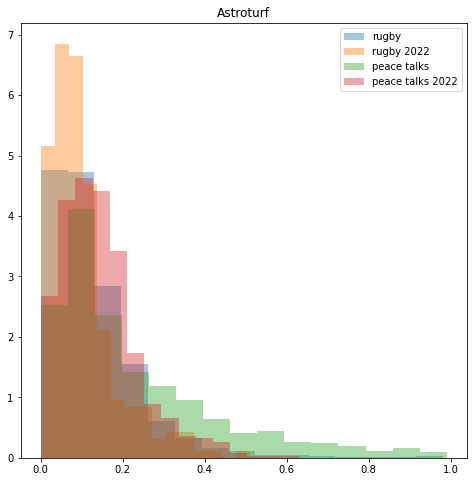

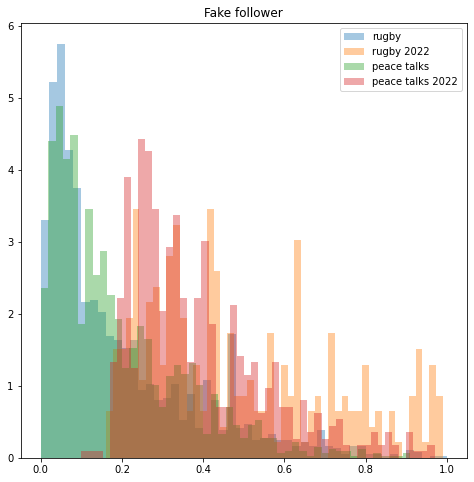

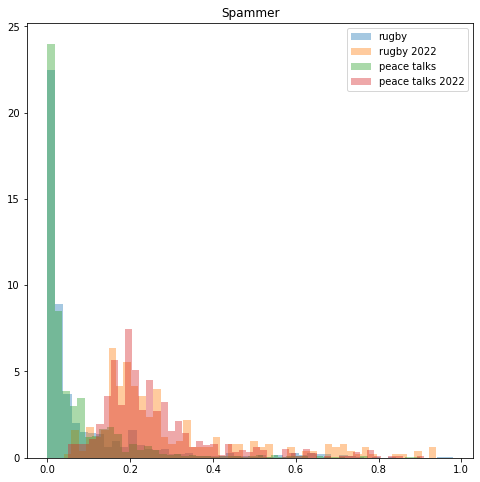

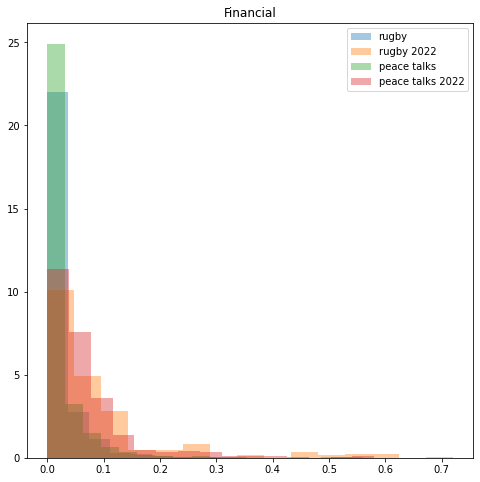

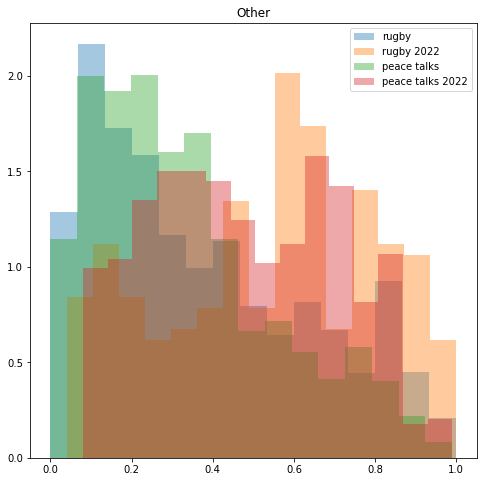

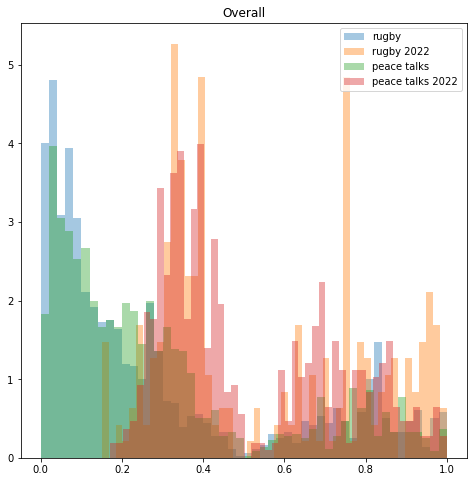

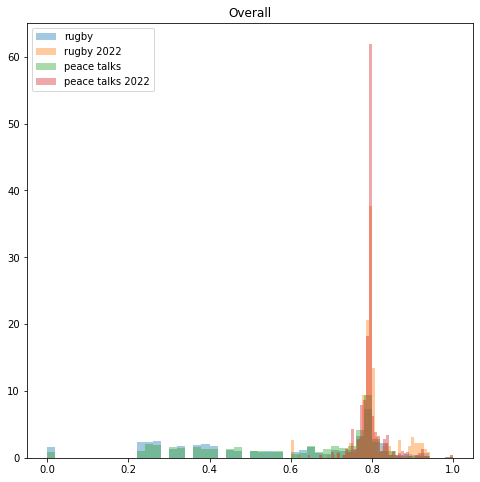

In [14]:
import numpy as np
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1,1, figsize = (8,8))
plt.hist(score_astroturf_rugby, 15, alpha = 0.4, label = 'rugby', density = True)
plt.hist(score_astroturf_rugby2022, 15, alpha = 0.4, label = 'rugby 2022', density = True)
plt.hist(score_astroturf_peace, 15, alpha = 0.4, label = 'peace talks', density = True)
plt.hist(score_astroturf_peace2022, 15, alpha = 0.4, label = 'peace talks 2022', density = True)
plt.title('Astroturf')
plt.legend()

fig, ax = plt.subplots(1,1, figsize = (8,8))
plt.hist(score_fake_follower_rugby, 50, alpha = 0.4, label = 'rugby', density = True)
plt.hist(score_fake_follower_rugby2022, 50, alpha = 0.4, label = 'rugby 2022', density = True)
plt.hist(score_fake_follower_peace, 50, alpha = 0.4, label = 'peace talks', density = True)
plt.hist(score_fake_follower_peace2022, 50, alpha = 0.4, label = 'peace talks 2022', density = True)
plt.title('Fake follower')
plt.legend()

fig, ax = plt.subplots(1,1, figsize = (8,8))
plt.hist(score_spammer_rugby, 50, alpha = 0.4, label = 'rugby', density = True)
plt.hist(score_spammer_rugby2022, 50, alpha = 0.4, label = 'rugby 2022', density = True)
plt.hist(score_spammer_peace, 50, alpha = 0.4, label = 'peace talks', density = True)
plt.hist(score_spammer_peace2022, 50, alpha = 0.4, label = 'peace talks 2022', density = True)
plt.title('Spammer')
plt.legend()

fig, ax = plt.subplots(1,1, figsize = (8,8))
plt.hist(score_financial_rugby, 15, alpha = 0.4, label = 'rugby', density = True)
plt.hist(score_financial_rugby2022, 15, alpha = 0.4, label = 'rugby 2022', density = True)
plt.hist(score_financial_peace, 15, alpha = 0.4, label = 'peace talks', density = True)
plt.hist(score_financial_peace2022, 15, alpha = 0.4, label = 'peace talks 2022', density = True)
plt.title('Financial')
plt.legend()

fig, ax = plt.subplots(1,1, figsize = (8,8))
plt.hist(score_other_rugby, 15, alpha = 0.4, label = 'rugby', density = True)
plt.hist(score_other_rugby2022, 15, alpha = 0.4, label = 'rugby 2022', density = True)
plt.hist(score_other_peace, 15, alpha = 0.4, label = 'peace talks', density = True)
plt.hist(score_other_peace2022, 15, alpha = 0.4, label = 'peace talks 2022', density = True)
plt.title('Other')
plt.legend()

fig, ax = plt.subplots(1,1, figsize = (8,8))
plt.hist(score_overall_rugby, 50, alpha = 0.4, label = 'rugby', density = True)
plt.hist(score_overall_rugby2022, 50, alpha = 0.4, label = 'rugby 2022', density = True)
plt.hist(score_overall_peace, 50, alpha = 0.4, label = 'peace talks', density = True)
plt.hist(score_overall_peace2022, 50, alpha = 0.4, label = 'peace talks 2022', density = True)
plt.title('Overall')
plt.legend()

fig, ax = plt.subplots(1,1, figsize = (8,8))
plt.hist(score_cap_rugby, 50, alpha = 0.4, label = 'rugby', density = True)
plt.hist(score_cap_rugby2022, 50, alpha = 0.4, label = 'rugby 2022', density = True)
plt.hist(score_cap_peace, 50, alpha = 0.4, label = 'peace talks', density = True)
plt.hist(score_cap_peace2022, 50, alpha = 0.4, label = 'peace talks 2022', density = True)
plt.title('Overall')
plt.legend()


In [48]:
tweets_en_df_peace2022.shape

(648, 17)

In [41]:
score_overall_rugby

0      0.97
1      0.60
2      0.31
3      0.75
4      0.25
5      0.39
6      0.29
7      0.78
8      0.64
9      0.78
10     0.39
11     0.39
12     0.63
13     0.39
14     0.75
15     0.66
16     0.77
17     0.30
18     0.84
19     0.81
20     0.86
21     0.29
22     0.63
23     0.39
24     0.31
25     0.35
26     0.31
27     0.26
28     0.94
29     0.33
30     0.34
31     0.33
32     0.33
33     0.39
34     0.33
35     0.33
36     0.33
37     0.15
38     0.67
39     0.15
40     0.37
41     0.72
42     0.94
43     0.31
44     0.22
45     0.42
46     0.45
47     0.76
48     0.24
49     0.88
50     0.39
51     0.90
52     0.59
53     0.73
54     0.38
55     0.38
56     0.39
57     0.60
58     0.39
59     0.31
60     0.39
61     0.32
62     0.38
63     0.24
64     0.32
65     0.65
66     0.84
67     0.32
68     0.94
69     0.70
70     0.38
71     0.21
72     0.94
73     0.88
74     0.90
75     0.76
76     0.27
77     0.83
78     0.60
79     0.87
80     0.97
81     0.32
82     0.87
83  

In [40]:
score_overall_rugby2022

0      0.97
1      0.60
2      0.31
3      0.75
4      0.25
5      0.39
6      0.29
7      0.78
8      0.64
9      0.78
10     0.39
11     0.39
12     0.63
13     0.39
14     0.75
15     0.66
16     0.77
17     0.30
18     0.84
19     0.81
20     0.86
21     0.29
22     0.63
23     0.39
24     0.31
25     0.35
26     0.31
27     0.26
28     0.94
29     0.33
30     0.34
31     0.33
32     0.33
33     0.39
34     0.33
35     0.33
36     0.33
37     0.15
38     0.67
39     0.15
40     0.37
41     0.72
42     0.94
43     0.31
44     0.22
45     0.42
46     0.45
47     0.76
48     0.24
49     0.88
50     0.39
51     0.90
52     0.59
53     0.73
54     0.38
55     0.38
56     0.39
57     0.60
58     0.39
59     0.31
60     0.39
61     0.32
62     0.38
63     0.24
64     0.32
65     0.65
66     0.84
67     0.32
68     0.94
69     0.70
70     0.38
71     0.21
72     0.94
73     0.88
74     0.90
75     0.76
76     0.27
77     0.83
78     0.60
79     0.87
80     0.97
81     0.32
82     0.87
83  

### Finding who is the most botlike:

In [50]:
tweets_en_df_rugby.loc[np.where((score_astroturf_rugby > 0.75))[0]]

,Unnamed: 0,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,Astroturf,Fake follower,Financial,Other,Overall,Self declared,Spammer,Cap
307,307,2022-03-19 21:54:17+00:00,1505301657948758022,"79 min\n\nFrance deservedly about to win the Grand Slam\n\nWhat are the commentator's final thoughts?\n\n""What do we think England can take from this game?""\n\nFFS! 🤔\n\nBest team in the 6 Nations.\n\nCongratulations @FranceRugby\n #FRAvENG",MikeFealey,1,Mike Fealey #JohnsonOut,en,0.85,0.22,0.10,0.41,0.85,0.02,0.02,0.833918
337,337,2022-03-19 21:51:07+00:00,1505300861836169216,"#GrandSlam against brexit England …, sweet! #FRAvENG #6nations2022 bravo les bleus @FranceRugby",provence2704,2,Nana#FBPE#3.5%#blm#fbppr#resist#💙nhs,en,0.78,0.16,0.00,0.19,0.17,0.00,0.00,0.641418
419,419,2022-03-19 21:03:48+00:00,1505288954219839498,@ScotsmanPaddy The commentary sums up just why I dislike having to view the rugby on ITV. France playing England off the park and all the pundits comments are o me miserum.,markrowantree,2,markrowantree,en,0.77,0.16,0.03,0.37,0.77,0.03,0.01,0.805478


In [23]:
tweets_en_df_peace.loc[np.where((score_astroturf_peace > 0.75))[0]]

,Unnamed: 0,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,User Created,Astroturf,Fake follower,Financial,Other,Overall,Self declared,Spammer,Cap
15,15,2022-02-19 23:59:10+00:00,1495186226462302210,"Harris says US 'stands with Ukraine' while warning Russia of 'swift, severe and united' consequences\n\nhttps://t.co/N7ulrjkm8a",deesbarbara,0,barbaradees,en,2009-09-25,0.96,0.20,0.03,0.58,0.96,0.01,0.01,0.915838
25,25,2022-02-19 23:58:58+00:00,1495186175744790532,Russia-Ukraine live updates: West braces for false-flag operations by Kremlin as leaders meet in Munich\nPutin sending out LIEs &amp; Propaganda so he can Murder more people &amp; take away their Freedom for his own GREED. Putin #Terrorist &amp; Murderer #Republican\n https://t.co/R3eFqzDB8H,PCadfael,0,P CADFAEL,en,2017-07-25,0.88,0.55,0.01,0.40,0.88,0.03,0.06,0.852405
40,40,2022-02-19 23:57:57+00:00,1495185921376989189,@akoz33 @ScottAdamsSays The only thing here is that there is no reason for Russia to invade Ukraine.,tony_sanky,0,Captain Haddock’s insults,en,2016-01-03,0.84,0.14,0.00,0.42,0.84,0.00,0.00,0.828755
83,83,2022-02-19 23:56:15+00:00,1495185492194861061,"Russia will be on the wrong side of history if they invade Ukraine. This time, Germany will help to take them down.\n\nIn World War II, the three great Allied powers—Great Britain, the United States, and the Soviet Union—formed a Grand Alliance that was the key to victory. https://t.co/7x03WdlVMz",gscucci,2,Gary,en,2009-11-10,0.91,0.21,0.00,0.25,0.91,0.00,0.02,0.874858
108,108,2022-02-19 23:55:24+00:00,1495185278364839939,@USPatriotSerena Russia/Ukraine border. All the rest of the winters he has left.,lovewindmills,1,Toni,en,2020-06-17,0.89,0.16,0.00,0.29,0.89,0.00,0.02,0.859506
111,111,2022-02-19 23:55:21+00:00,1495185265169731586,"@Tracey_HSTeach @robfardon ""Putin wants to be the person who, on his watch, in his presidency, pulls Ukraine back into Russia’s orbit. And he could be president until 2036, in terms of what’s possible for him…""",chenx064,4,🌍 Јаков Минг Дановић 🌏,en,2008-02-03,0.83,0.15,0.00,0.32,0.83,0.01,0.00,0.824092
143,143,2022-02-19 23:53:58+00:00,1495184917709402113,@LSTrip44 @JustEvFL @Stonekettle The Chinese are dead set against Russia’s maneuvers. Putin will not end with Ukraine but he won’t use nuclear weapons. Think through YOUR isolationist answer carefully. If you’re pro communist authoritarian regimes- he’s your guy.,Kathlee71013772,15,KathleenFrances🇮🇪☘️,en,2019-08-05,0.83,0.04,0.00,0.27,0.10,0.00,0.00,0.475677
151,151,2022-02-19 23:53:22+00:00,1495184768459325444,@monoblancoatx @SpaghettiKozak So you support what Russia is doing right now in Ukraine or not? \n\nThat’s the only real question here. \n\nYes or no.,Inkling61,3,Bathsheba Dreams in Blue 🌻🌻🌻,en,2011-08-17,0.83,0.12,0.00,0.25,0.83,0.01,0.00,0.824092
388,388,2022-02-19 23:43:47+00:00,1495182358089109509,I am not qualified to determine what should or shouldn't happen with the Ukraine.\n\nI know Russia are the bad guys. I know that we're Russia's only real 'competition' (maybe). And I know that allowing the bully to 'win' isn't the way forward.\n\nI also don't think that the US\n1/,roknrolzombie,5,ℜ𝔬𝔨𝔫𝔯𝔬𝔩 𝔓𝔢𝔱𝔢𝔯𝔰𝔢𝔫 🇺🇸🌻4⃣2⃣0⃣,en,2011-04-27,0.88,0.16,0.01,0.30,0.88,0.00,0.00,0.852405
419,419,2022-02-20 23:59:23+00:00,1495548670061776897,Why do the neocons want war? The USA and NATO have been interfering in Ukraine for a long time. I hope Ukraine doesn't take the $ and allow NATO &amp; the USA to get the war they want with Russia.\nEnough is enough. https://t.co/Yy6ZBQCnC7,StudentOfDrA,1,Protect children and animalsⓋ formerly Teresa 🇷🇺,en,2010-11-13,0.94,0.10,0.01,0.25,0.94,0.00,0.01,0.899551


In [15]:
tweets_en_df_rugby.loc[np.where((score_fake_follower_rugby > 0.75))[0]]

,Unnamed: 0,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,User Created,Astroturf,Fake follower,Financial,Other,Overall,Self declared,Spammer,Cap
14,14,2022-03-01 23:52:32+00:00,1.498808e+18,"Rugby League Season 2022 is less than 2 weeks away. Order your Proscore Tipping pack now and receive Express Post at no extra charge. Not sure what you need, call us on 1800 684 222 or online https://t.co/lP0xsihd4o\n#proscore #proscorerugbyleaguetipping #rugbyleaguetipping https://t.co/EcErYVG7kO",Proscore2,0,Proscore,en,2022-01-16,0.03,0.90,0.05,0.91,0.91,0.78,0.72,0.874858
34,34,2022-03-01 23:43:27+00:00,1.498806e+18,@BBCSport @5liveSport Worst game I’ve been at in Landsdowne road …. Never a red…. Ruined the game and such a poor advertisement for rugby …. Italy in fairness tried their best ….,HarryMu81697895,0,Harry Murphy,en,2017-10-12,0.05,0.94,0.27,0.62,0.94,0.49,0.64,0.899551
106,106,2022-03-01 23:13:14+00:00,1.498799e+18,"@KyleSinckler sat working night shift and watching Strength of Purpose, have to say Kyle comes across as a great human being, what he said hit a note and I will be watching again with my 14 year old rugby playing son, brilliant great person and a great player 👍",andy_thornber,1,Andy Thornber,en,2022-01-03,0.06,1.00,0.49,0.76,1.00,0.55,0.62,1.000000
172,172,2022-03-01 22:52:25+00:00,1.498793e+18,#rugby history today 01/03 in 1975 : Scotland 12-10 Wales - WRU lose in Murrayfield in 1975 rugby test match https://t.co/KBNB7mId4J,WalesScotland,0,Wales-Scotland-Rugby,en,2013-05-14,0.02,0.78,0.13,0.96,0.96,0.87,0.67,0.915838
391,391,2022-03-01 17:59:44+00:00,1.498720e+18,@SixNationsRugby Tom David,Colyn999,1,ColynW,en,2020-05-28,0.08,0.91,0.04,0.42,0.91,0.54,0.47,0.874858
515,515,2022-03-02 23:52:31+00:00,1.499171e+18,"Rugby League Season 2022 just days away. Order your Proscore Tipping pack now and receive Express Post at no extra charge. Not sure what you need, call us on 1800 684 222 or online https://t.co/lP0xsihd4o\n#proscore #proscorerugbyleaguetipping #rugbyleaguetipping https://t.co/ep3mD9n4Oq",Proscore2,0,Proscore,en,2022-01-16,0.03,0.90,0.05,0.91,0.91,0.78,0.72,0.874858
548,548,2022-03-02 23:36:12+00:00,1.499167e+18,@Marconificent @Abramjee Rugby penalty 😂😂😂,TebeleMakgoba,0,John Tebele Makgoba,en,2022-02-20,0.03,0.86,0.56,0.94,0.94,0.66,0.80,0.899551
705,705,2022-03-02 22:33:47+00:00,1.499151e+18,@SixNationsRugby I now think it is 2008,rikharrison11,0,Rachel harrison,en,2014-11-09,0.00,0.79,0.04,0.63,0.79,0.46,0.28,0.810078
783,783,2022-03-02 22:33:47+00:00,1.499151e+18,@SixNationsRugby I now think it is 2008,rikharrison11,0,Rachel harrison,en,2014-11-09,0.00,0.79,0.04,0.63,0.79,0.46,0.28,0.810078
1008,1008,2022-03-03 23:54:45+00:00,1.499534e+18,"@MarkFletch117 @AlStewartOBE Does your world go beyond pubs ,beer,football,holidays,dogs,and rugby?",kumarkurup2,0,kumarkurup,en,2017-08-10,0.00,0.83,0.05,0.75,0.83,0.55,0.33,0.824092


In [16]:
tweets_en_df_peace.loc[np.where((score_fake_follower_peace > 0.75))[0]]

,Unnamed: 0,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,User Created,Astroturf,Fake follower,Financial,Other,Overall,Self declared,Spammer,Cap
27,27,2022-02-19 23:58:54+00:00,1495186160821362693,How many times you gon keep threatening Russia with sanctions? Incessant warnings make you look weak and appear to be water rolling off a duck's back. I suggest you prepare instead &amp; provide concrete supports to Ukraine. #BeResolute\n\n@WhiteHouse @potus @VP,jangelee,0,Keen Observer,en,2013-03-18,0.06,0.91,0.20,0.70,0.91,0.57,0.77,0.874858
133,133,2022-02-19 23:54:28+00:00,1495185044050259968,"@POTUS If Russia invades Ukraine, shit happens. If the US world police decide to intervene in EU internal affairs, THAT will be the trigger for a war, which will affect millions of citizens, and none of them American. Dear #Potus, let us deal with our own shit. You deal with yours.",LiberalisteneMR,0,Liberalistene Møre & Romsdal,en,2022-01-25,0.02,0.84,0.33,0.75,0.84,0.68,0.51,0.828755
230,230,2022-02-19 23:49:58+00:00,1495183911856779268,@HannaLiubakova They are half Russia blood system' s civil and UKRAINE people at the same time.,guoxiujiao11,0,郭秀嬌,en,2021-11-14,0.08,0.82,0.08,0.90,0.90,0.62,0.31,0.867012
664,664,2022-02-20 23:48:52+00:00,1495546022935867394,"Recent History of Russia, Poland, Germany, Ukraine https://t.co/J9MYoZswIr",DonnajeanMalmq1,1,Donnajean Malmquist,en,2021-09-23,0.11,0.80,0.19,0.72,0.80,0.71,0.66,0.812935
679,679,2022-02-20 23:48:21+00:00,1495545892182671370,"Russia-Ukraine conflict imminent says US, Sydney train strike cancels all services, The Queen tests positive for COVID, NSW COVID cases grow, Victoria COVID cases grow, AGL rejects Mike Cannon-Brookes takeover bid, Qld COVID cases grow https://t.co/w1RevNP7w5",Mohammad_ali_73,0,Mohammad Ali,en,2021-02-03,0.11,0.80,0.03,0.88,0.88,0.71,0.26,0.852405
687,687,2022-02-20 23:47:47+00:00,1495545749744263168,@BABOOMBA99 @jpott_pt @SebGorka Yeah because this is really the democratic party invading ukraine.... We probably should be helping Russia,ForRhoades,1,Kevin Rhoades For Congress,en,2021-07-08,0.02,0.76,0.13,0.76,0.76,0.72,0.27,0.803671
743,743,2022-02-20 23:45:41+00:00,1495545222331252754,Why is the US responsible for the differences between Russia and the Ukraine ? Why are the prices of everything elevated in the US? Something needs to change. This is ridiculous.,dianeneyk,0,Diane S,en,2009-03-19,0.02,0.91,0.15,0.61,0.91,0.45,0.69,0.874858
806,806,2022-02-20 23:43:05+00:00,1495544568120492034,TO PRESIDENT BIDEN &amp; OUR EUROPEAN ALLIES. IT WOULD BE VERY UNWISE PRECIPITOUS &amp; PROVACATIVE TO PREEMPTOUSLY IMPOSE SANCTIONS ON RUSSIA. YOU MAY BECOME JUST THE CATALYST NEEDED FOR PUTIN TO INVADE UKRAINE,bryan_thrudea,0,BRYAN THRUDEA,en,2021-03-01,0.09,0.82,0.23,0.75,0.82,0.69,0.50,0.819915
1077,1077,2022-02-21 23:56:51+00:00,1495910421139800065,Russia is invading Ukraine right now. This is happening. They have to be pushed back. Zelensky needs to openly admit he needs the help of his European and American allies.,BlogSauls,0,ArSaul,en,2020-12-19,0.07,0.88,0.18,0.67,0.88,0.63,0.76,0.852405
1277,1277,2022-02-22 23:59:38+00:00,1496273508812398597,🔴 📈 🚀 +612$ Profit- Live Day Trading Futures - Russia Ukraine Invasion News https://t.co/t5e6lIH4YL via @YouTube,RdgdTrader,1,RDGD Trader,en,2022-02-21,0.06,0.77,0.13,0.75,0.77,0.53,0.56,0.805478


In [25]:
tweets_en_df_rugby.loc[np.where((score_overall_rugby > 0.75) & (score_self_declared_rugby < 0.6))[0]]

,Unnamed: 0,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,Astroturf,Fake follower,Financial,Other,Overall,Self declared,Spammer,Cap
47,47,2022-03-18 18:44:27+00:00,1504891498172665856,France v England predictions and rugby union tips: Crunch time for Les Bleus - Racing Post https://t.co/V7V39E0Aj9,ruckmeslowly,0,Ruck On,en,0.07,0.29,0.02,0.80,0.80,0.09,0.18,0.812935
53,53,2022-03-18 17:44:28+00:00,1504876402805551108,France v England predictions and rugby union tips: Crunch time for Les Bleus - Racing Post https://t.co/Z7o6KxMO9b,ruckmeslowly,1,Ruck On,en,0.07,0.29,0.02,0.80,0.80,0.09,0.18,0.812935
75,75,2022-03-18 14:00:45+00:00,1504820102566395905,"@SixNationsRugby Most likely. I guarantee if England beat France, Ireland will slip up against Scotland and they’ll win it anyway. Much as I love Ireland, it’s not likely they’ll take it",Superbeans89,2,Dean Rowlinson,en,0.00,0.41,0.06,0.77,0.77,0.58,0.14,0.805478
78,78,2022-03-18 13:36:01+00:00,1504813879460872192,"@SixNationsRugby @EnglandRugby @FranceRugby The Premiership teams provide a landslide of tries ever weekend, exciting attacking play, skilful players and Eddie Jones’s team cannot buy a try. Go figure! What’s the betting that after England lose to France that Fast Eddie blames the Premiership structure etc..",kiely_patrick,0,Patrick kiely,en,0.07,0.79,0.45,0.90,0.90,0.57,0.62,0.867012
102,102,2022-03-18 08:23:49+00:00,1504735310084820995,Preview: France v England via @SixNationsRugby https://t.co/iWLaYmoLIF,Aldinasoor2014,0,Aldinasoor,en,0.11,0.44,0.09,0.80,0.80,0.22,0.26,0.812935
157,157,2022-03-19 23:44:41+00:00,1505329444306759681,Rugby-Superb France beat England to claim long-awaited Six Nations Grand Slam https://t.co/ryWilrWGN6,dev_discourse,2,Devdiscourse,en,0.09,0.33,0.01,0.83,0.83,0.49,0.06,0.824092
177,177,2022-03-19 22:55:08+00:00,1505316971294126081,"France vs England LIVE: Six Nations rugby result, final score and reaction as France seal Grand Slam\n\n#France | #England | #Nations | #Result\n\nBreaking News \n👉 https://t.co/ETjAATDQMf https://t.co/FL02jDxZIp",muyaniearth,0,Go Confidently 🇺🇸,en,0.29,0.67,0.02,0.91,0.91,0.54,0.25,0.874858
212,212,2022-03-19 22:22:36+00:00,1505308786952708101,@SixNationsRugby @FranceRugby Not bad enough watching England lose but having to do it with Pugatch and the shite of the ITV adverts…#increasethelicencefee #mentalhealth #wtf,ian33760853,1,ian,en,0.09,0.89,0.23,0.78,0.89,0.50,0.56,0.859506
226,226,2022-03-19 22:14:44+00:00,1505306805529944066,Rugby-Superb France beat England to claim long-awaited Six Nations Grand Slam https://t.co/40WCPiJdc8,dev_discourse,1,Devdiscourse,en,0.09,0.35,0.01,0.83,0.83,0.50,0.06,0.824092
253,253,2022-03-19 22:06:05+00:00,1505304630393196552,@ITVSport Who was man of match in the France v England rugby match??Nobodies said yet??;-D,MoffattDamon,0,Damon Moffatt,en,0.02,0.30,0.19,0.82,0.82,0.58,0.08,0.819915


In [26]:
tweets_en_df_peace.loc[np.where((score_overall_peace > 0.75) & (score_self_declared_peace < 0.6))[0]]

,Unnamed: 0,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,Astroturf,Fake follower,Financial,Other,Overall,Self declared,Spammer,Cap
11,11,2022-03-27 23:08:53+00:00,1508219534611730435,"Trump Wouldn't Be 'Capable' Of Ukraine Peace Talks With Moscow, Says John Bolton\nhttps://t.co/pp1bB0ij4E",nyyankee1970,0,nyyankee1970,en,0.79,0.57,0.02,0.55,0.79,0.10,0.05,0.810078
19,19,2022-03-27 22:41:13+00:00,1508212574374047751,"Current reporting, ""Russia and Ukraine will hold another round of in-person peace talks in Turkey starting tomorrow, the head of Kyiv’s delegation says"". https://t.co/PS1qXam8wa",koslen_bambi,6,Bambi Koslen,en,0.77,0.36,0.00,0.33,0.77,0.02,0.00,0.805478
20,20,2022-03-27 22:39:53+00:00,1508212240171905028,The Ukrainian President made the claim as part of an exasperated plea for fighter jets; neutrality is on the table at peace talks; Ukraine claims victories near Kyiv. Follow the latest here. https://t.co/mYiwQi6gdl,FinancialReview,1,Financial Review,en,0.06,0.17,0.01,0.91,0.91,0.50,0.03,0.874858
41,41,2022-03-27 22:09:00+00:00,1508204465102499851,Russian and Ukrainian delegations to hold new round of peace talks\n\n#RussiaUkraineWar #Ukraine #Russia \nhttps://t.co/2TXf4tqRKS,anwar0262,0,AH Siddiqui,en,0.07,0.32,0.01,0.77,0.77,0.56,0.11,0.805478
42,42,2022-03-27 22:08:53+00:00,1508204437088747529,"Trump Wouldn’t Be ‘Capable’ Of Ukraine Peace Talks With Moscow, Says John Bolton\nhttps://t.co/sGqHNK2y5E",Sylvaners,0,sylvaner,en,0.86,0.16,0.03,0.48,0.86,0.03,0.01,0.839586
48,48,2022-03-27 22:03:10+00:00,1508202998194974724,Zelensky says Ukraine ready to discuss neutrality in peace talks with Russia https://t.co/6UKglAcfqK,FT,152,Financial Times,en,0.09,0.27,0.03,0.79,0.79,0.46,0.03,0.810078
50,50,2022-03-27 22:00:21+00:00,1508202290720694277,Chief International Correspondent Paul Workman has the latest from Ukraine as another round of peace talks is set to begin on Monday. https://t.co/xqewj4BsZL,CTVNewsVI,0,CTV News Vancouver Island,en,0.11,0.26,0.08,0.79,0.79,0.53,0.03,0.810078
51,51,2022-03-27 21:59:58+00:00,1508202194738290688,Zelensky says Ukraine ready to discuss neutrality in peace talks with Russia https://t.co/Yg6u3TFWdT,ftbrussels,3,FT Europe,en,0.03,0.21,0.00,0.87,0.87,0.59,0.03,0.845754
69,69,2022-03-27 21:17:11+00:00,1508191425598349312,"Andy Vermaut shares:Trump would not be 'capable' of holding Ukraine-Russia peace talks, says his former national security adviser John Bolton: submitted by /u/ThroughtYourMind \n [link] [comments] https://t.co/hPkkL6nViF Thank you! https://t.co/lhbw4WrmHC",AndyVermaut,0,Andy Vermaut,en,0.37,0.57,0.01,0.80,0.80,0.48,0.08,0.812935
88,88,2022-03-27 20:45:27+00:00,1508183442294419459,Russia-Ukraine live updates: Agreement reached on new round of in-person peace talks - ABC News - https://t.co/hWCvyCBrf0 via @ABC,typo_cat,0,CatT 🌻🇺🇦Reigning Typo Queen🌻👑 🚫DMs!💉💉💉😷,en,0.92,0.31,0.01,0.35,0.92,0.02,0.00,0.882963


In [11]:
tweets_en_df_rugby.loc[np.where((score_overall_rugby > 0.75) & (score_self_declared_rugby < 0.6) & (score_other_rugby < 0.6))[0]]

,Unnamed: 0,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,Astroturf,Fake follower,Financial,Other,Overall,Self declared,Spammer,Cap
307,307,2022-03-19 21:54:17+00:00,1505301657948758022,"79 min\n\nFrance deservedly about to win the Grand Slam\n\nWhat are the commentator's final thoughts?\n\n""What do we think England can take from this game?""\n\nFFS! 🤔\n\nBest team in the 6 Nations.\n\nCongratulations @FranceRugby\n #FRAvENG",MikeFealey,1,Mike Fealey #JohnsonOut,en,0.85,0.22,0.10,0.41,0.85,0.02,0.02,0.833918
357,357,2022-03-19 21:48:42+00:00,1505300255956475908,@UTDJack10 @FranceRugby I totally agree though. England are pretty shit at the moment,Digby_sdb,0,Sam Bolton,en,0.06,0.78,0.24,0.53,0.78,0.56,0.54,0.807604
392,392,2022-03-19 21:26:47+00:00,1505294740580929547,"@FranceRugby England fan here, it's a joy to watch this french team",Digby_sdb,11,Sam Bolton,en,0.06,0.78,0.24,0.53,0.78,0.56,0.54,0.807604
419,419,2022-03-19 21:03:48+00:00,1505288954219839498,@ScotsmanPaddy The commentary sums up just why I dislike having to view the rugby on ITV. France playing England off the park and all the pundits comments are o me miserum.,markrowantree,2,markrowantree,en,0.77,0.16,0.03,0.37,0.77,0.03,0.01,0.805478


In [12]:
tweets_en_df_peace.loc[np.where((score_overall_peace > 0.75) & (score_self_declared_peace < 0.6) & (score_other_peace < 0.6))[0]]

,Unnamed: 0,Datetime,Tweet Id,Text,Username,Like Count,Display Name,Language,Astroturf,Fake follower,Financial,Other,Overall,Self declared,Spammer,Cap
11,11,2022-03-27 23:08:53+00:00,1508219534611730435,"Trump Wouldn't Be 'Capable' Of Ukraine Peace Talks With Moscow, Says John Bolton\nhttps://t.co/pp1bB0ij4E",nyyankee1970,0,nyyankee1970,en,0.79,0.57,0.02,0.55,0.79,0.10,0.05,0.810078
19,19,2022-03-27 22:41:13+00:00,1508212574374047751,"Current reporting, ""Russia and Ukraine will hold another round of in-person peace talks in Turkey starting tomorrow, the head of Kyiv’s delegation says"". https://t.co/PS1qXam8wa",koslen_bambi,6,Bambi Koslen,en,0.77,0.36,0.00,0.33,0.77,0.02,0.00,0.805478
42,42,2022-03-27 22:08:53+00:00,1508204437088747529,"Trump Wouldn’t Be ‘Capable’ Of Ukraine Peace Talks With Moscow, Says John Bolton\nhttps://t.co/sGqHNK2y5E",Sylvaners,0,sylvaner,en,0.86,0.16,0.03,0.48,0.86,0.03,0.01,0.839586
88,88,2022-03-27 20:45:27+00:00,1508183442294419459,Russia-Ukraine live updates: Agreement reached on new round of in-person peace talks - ABC News - https://t.co/hWCvyCBrf0 via @ABC,typo_cat,0,CatT 🌻🇺🇦Reigning Typo Queen🌻👑 🚫DMs!💉💉💉😷,en,0.92,0.31,0.01,0.35,0.92,0.02,0.00,0.882963
139,139,2022-03-27 19:11:24+00:00,1508159770070601728,"Lets see, as one of the elitist DC ""Smart ppl"", I'm sure you realize #Puntin invaded #Ukraine under Obama &amp; #JoeBiden -NOT #Trump ... would not be 'capable' of holding Ukraine-Russia peace talks, says his former national security adviser John Bolton https://t.co/5yrMuN508E",TroyFauber,0,Troy Fauber,en,0.86,0.17,0.01,0.33,0.86,0.00,0.00,0.839586
223,223,2022-03-27 16:38:50+00:00,1508121379064930304,"Trump Wouldn’t Be ‘Capable’ Of Ukraine Peace Talks With Moscow, Says John Bolton\nhttps://t.co/Ten2Esdt51",fireworkbonnie,1,Letter writer,en,0.90,0.29,0.00,0.27,0.90,0.00,0.00,0.867012
224,224,2022-03-27 16:38:25+00:00,1508121271984349197,"trump would not be CAPABLE of any of the numerous challenges President Biden is dealing with.\n\nTrump Wouldn't Be 'Capable' Of Ukraine Peace Talks With Moscow, Says John Bolton\nhttps://t.co/Ten2Esdt51",fireworkbonnie,2,Letter writer,en,0.90,0.29,0.00,0.27,0.90,0.00,0.00,0.867012
237,237,2022-03-27 16:12:05+00:00,1508114644241690625,Business Insider: John Bolton: Trump not 'capable' of holding Ukraine-Russia peace talks.\nhttps://t.co/OVXxb0PijY\n\nvia @GoogleNews,proudCanadavet,0,brian o,en,0.94,0.53,0.06,0.54,0.94,0.04,0.03,0.899551
254,254,2022-03-27 15:44:36+00:00,1508107730258640899,👀\nJohn Bolton: Trump Not 'Capable' of Holding Ukraine-Russia Peace Talks https://t.co/qv65BG4xAF,Annamaria2427,0,OneDownManyToGo🌻,en,0.98,0.25,0.02,0.50,0.98,0.00,0.00,0.930754
256,256,2022-03-27 15:42:20+00:00,1508107156704403457,"Trump Wouldn't Be 'Capable' Of Ukraine Peace Talks With Moscow, Says John Bolton https://t.co/GKTyZeVNHk via @Yahoo",oscalope,1,mike forte,en,0.92,0.27,0.08,0.46,0.92,0.00,0.01,0.882963
